In [88]:
import os
import networkx as nx
import pandas as pd

data_directory = "twitter"

G = nx.Graph()
file_count = 0
max_files = 100  
for filename in os.listdir(data_directory):
    if filename.endswith(".edges"):  
        file_path = os.path.join(data_directory, filename)        
        with open(file_path, 'r') as f:
            for line in f:
                u, v = line.strip().split()  
                G.add_edge(u, v)
        
        file_count += 1  
        
        if file_count >= max_files:
            break

print("Number of nodes:", G.number_of_nodes())
print("Number of edges:", G.number_of_edges())
print("Graph is directed:", G.is_directed())
print("Graph nodes:", G.nodes())
print("Graph edges:", G.edges())

Number of nodes: 10174
Number of edges: 143761
Graph is directed: False
Graph nodes: ['122381821', '14180231', '43933017', '14783047', '18581803', '7860742', '45416789', '127178017', '242941896', '17224642', '8634422', '45862504', '141508391', '20935355', '65913144', '116807493', '243267948', '7872262', '14498387', '21554226', '17759701', '61949499', '20904455', '105310392', '20397258', '14774830', '13894102', '1134701', '90561258', '14100451', '16506255', '29054594', '78027566', '35926608', '108719642', '52330027', '111116727', '24641194', '196400161', '242013901', '131333738', '22997147', '24586098', '19458216', '51835387', '101633415', '38108292', '264624779', '25395355', '24081780', '14471778', '16453996', '104352067', '222640532', '25621787', '31477674', '31949053', '5623612', '24004172', '29043456', '170675435', '22679419', '386968423', '21681252', '21020539', '42361118', '26256596', '16098603', '60968363', '8269222', '242024994', '38542252', '509096468', '23179034', '12611642', 

##### Extracting EGO Networks

In [67]:
ego_nodes = list(G.nodes())
for ego in ego_nodes:
    ego_network = nx.ego_graph(G, ego)
    print(f"Ego network for {ego} has {ego_network.number_of_nodes()} nodes and {ego_network.number_of_edges()} edges")


Ego network for 122381821 has 66 nodes and 719 edges
Ego network for 14180231 has 121 nodes and 1904 edges
Ego network for 43933017 has 137 nodes and 3239 edges
Ego network for 14783047 has 40 nodes and 567 edges
Ego network for 18581803 has 421 nodes and 9789 edges
Ego network for 7860742 has 381 nodes and 8602 edges
Ego network for 45416789 has 212 nodes and 5374 edges
Ego network for 127178017 has 95 nodes and 1148 edges
Ego network for 242941896 has 46 nodes and 755 edges
Ego network for 17224642 has 167 nodes and 3397 edges
Ego network for 8634422 has 17 nodes and 67 edges
Ego network for 45862504 has 165 nodes and 2286 edges
Ego network for 141508391 has 166 nodes and 3842 edges
Ego network for 20935355 has 130 nodes and 2633 edges
Ego network for 65913144 has 226 nodes and 5603 edges
Ego network for 116807493 has 69 nodes and 927 edges
Ego network for 243267948 has 45 nodes and 820 edges
Ego network for 7872262 has 137 nodes and 3240 edges
Ego network for 14498387 has 180 nodes 

##### Independent Cascade Model

In [68]:
import random

def independent_cascade(G, seed, p=0.1):
    active_nodes = set([seed])
    newly_active = set([seed])
    
    while newly_active:
        next_active = set()
        for node in newly_active:
            neighbors = set(G.neighbors(node))
            for neighbor in neighbors - active_nodes:
                if random.random() <= p:  
                    next_active.add(neighbor)
        active_nodes.update(newly_active)
        newly_active = next_active
    return active_nodes

seed_node = list(G.nodes())[0]
cascade = independent_cascade(G, seed_node, p=0.05)
print(f"Nodes activated by cascade: {cascade}")


Nodes activated by cascade: {'424548522', '77397670', '250303199', '184867743', '47667972', '213924346', '73542569', '407977463', '208891656', '18414137', '15644019', '19930345', '382667125', '204446054', '25123654', '19886913', '78416387', '403009162', '14051156', '18176833', '158414847', '16250230', '14308857', '17365270', '184986169', '98199847', '1140451', '16172482', '193107999', '7434902', '24961671', '8032822', '187773078', '28737365', '121689493', '279863186', '25649234', '245915466', '65285104', '247823881', '341756256', '160229483', '18445879', '40759527', '271604248', '486366544', '11625912', '96843721', '51092346', '63207451', '57315608', '391675394', '610533', '277675909', '123743369', '32903767', '30007505', '27074856', '95357148', '15888142', '69193714', '384057286', '17831432', '11666332', '18169053', '52144222', '241109716', '92079887', '17863018', '25973266', '146729999', '120627547', '120122627', '37066863', '46681997', '15080503', '734493', '93699438', '192037413', 

##### Community Detection

Louvain Detected Communities:
Community 0: ['122381821', '14180231', '43933017', '14783047', '18581803', '7860742', '45416789', '127178017', '242941896', '17224642', '141508391', '20935355', '65913144', '116807493', '243267948', '7872262', '14498387', '21554226', '17759701', '61949499', '20904455', '105310392', '20397258', '14774830', '1134701', '90561258', '35926608', '108719642', '52330027', '111116727', '24641194', '196400161', '242013901', '131333738', '22997147', '24586098', '51835387', '101633415', '24081780', '14471778', '16453996', '104352067', '222640532', '31477674', '31949053', '5623612', '24004172', '29043456', '170675435', '22679419', '386968423', '21681252', '21020539', '42361118', '26256596', '16098603', '60968363', '8269222', '242024994', '509096468', '23179034', '217932743', '26676260', '100174502', '82139087', '21195122', '26033920', '341697578', '83506209', '88807478', '8004732', '14983833', '20661527', '44409315', '43933723', '39212992', '18069427', '310232962', '42

/tmp/ipykernel_43953/2595115205.py:17: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  nx.draw(G, pos, node_color=colors, with_labels=True, cmap=plt.cm.get_cmap('Set3'))


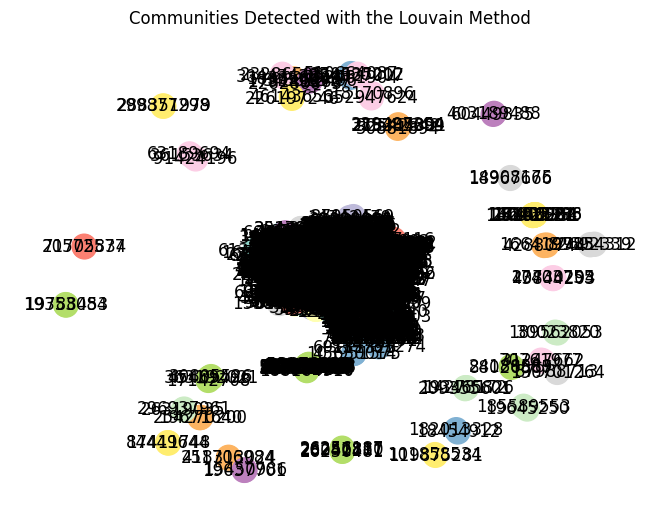

In [73]:
import community.community_louvain as community_louvain 
import networkx as nx
import matplotlib.pyplot as plt

louvain_communities = community_louvain.best_partition(G) 

print("Louvain Detected Communities:")
for community_id in set(louvain_communities.values()):
    community_nodes = [node for node, comm in louvain_communities.items() if comm == community_id]
    print(f"Community {community_id}: {community_nodes}")

pos = nx.spring_layout(G)
colors = [louvain_communities[node] for node in G.nodes()]
nx.draw(G, pos, node_color=colors, with_labels=True, cmap=plt.cm.get_cmap('Set3'))
plt.title("Communities Detected with the Louvain Method")
plt.show()

##### Centrality Measures

In [74]:
import networkx as nx
from joblib import Parallel, delayed

def compute_centrality(G):
    degree_centrality = nx.degree_centrality(G)
    betweenness_centrality = nx.betweenness_centrality(G)
    eigenvector_centrality = nx.eigenvector_centrality(G)
    return degree_centrality, betweenness_centrality, eigenvector_centrality

results = Parallel(n_jobs=-1)(delayed(compute_centrality)(G) for _ in range(1))

degree_centrality, betweenness_centrality, eigenvector_centrality = results[0]

print("Top 5 Nodes by Degree Centrality:")
top_degree = sorted(degree_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
print(top_degree)

print("Top 5 Nodes by Betweenness Centrality:")
top_betweenness = sorted(betweenness_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
print(top_betweenness)

print("Top 5 Nodes by Eigenvector Centrality:")
top_eigenvector = sorted(eigenvector_centrality.items(), key=lambda x: x[1], reverse=True)[:5]
print(top_eigenvector)

Top 5 Nodes by Degree Centrality:
[('40981798', 0.07460925980536715), ('43003845', 0.06212523346112257), ('34428380', 0.06035584390052098), ('22462180', 0.06015924506045414), ('3359851', 0.05976604738032045)]
Top 5 Nodes by Betweenness Centrality:
[('40981798', 0.1430594336276337), ('3359851', 0.11899706535572836), ('813286', 0.05582050336471272), ('18581803', 0.048388916708297994), ('90420314', 0.04242509902301939)]
Top 5 Nodes by Eigenvector Centrality:
[('40981798', 0.18927752716031077), ('22462180', 0.1837084716766331), ('34428380', 0.1831548916909211), ('43003845', 0.1818398871690198), ('221829166', 0.11809754241385008)]


##### Threshold Model

In [75]:
def threshold_model(G, seed_nodes, threshold=0.1):
    active_nodes = set(seed_nodes)
    newly_active = set(seed_nodes)
    thresholds = {node: random.uniform(0, 1) for node in G.nodes()}

    while newly_active:
        next_active = set()
        for node in newly_active:
            neighbors = set(G.neighbors(node))
            for neighbor in neighbors - active_nodes:
                active_neighbors = len([n for n in G.neighbors(neighbor) if n in active_nodes])
                if active_neighbors / G.degree(neighbor) >= thresholds[neighbor]:
                    next_active.add(neighbor)
        active_nodes.update(newly_active)
        newly_active = next_active
    return active_nodes

seed_nodes = random.sample(list(G.nodes()), 5)
threshold_cascade = threshold_model(G, seed_nodes, threshold=0.2)
print(f"Nodes activated by threshold model from seed nodes {seed_nodes}: {threshold_cascade}")


Nodes activated by threshold model from seed nodes ['15251260', '336847617', '1688461', '21724128', '228555074']: {'360127935', '131506681', '282679866', '61246483', '134548250', '418665915', '383830013', '110278048', '73434013', '151338729', '139192364', '196429355', '356190582', '127016368', '199010047', '177589947', '131029775', '337245056', '289149940', '307058731', '382667125', '217800202', '204446054', '67974705', '127249741', '371828390', '147665130', '68687095', '229871864', '40525364', '239222686', '95490944', '17116707', '33664772', '187773078', '503275615', '196327549', '176566242', '322687731', '97251730', '82739072', '244546187', '66300747', '402699476', '19705747', '213715260', '387306656', '337299192', '201003211', '173732041', '200559228', '287941702', '136615027', '48887040', '230484387', '227454804', '155266313', '306770757', '346828777', '28111899', '361827868', '137156454', '224832743', '17868918', '159995010', '500400765', '54106670', '221829166', '163568016', '178

##### Classify nodes

In [76]:
def classify_role(ego_network):
    degree_centrality = nx.degree_centrality(ego_network)
    betweenness_centrality = nx.betweenness_centrality(ego_network)
    roles = {}
    for node in ego_network.nodes:
        if degree_centrality[node] > 0.5:
            roles[node] = 'Influencer'
        elif betweenness_centrality[node] > 0.3:
            roles[node] = 'Bridge'
        else:
            roles[node] = 'Isolate'
    return roles

for ego in ego_nodes:
    if ego in G.nodes:
        ego_network = nx.ego_graph(G, ego)
        roles = classify_role(ego_network)
        print(f"Roles in Ego Network of {ego}: {roles}")
    else:
        print(f"Node {ego} is not in the graph G.")


Roles in Ego Network of 122381821: {'35722372': 'Isolate', '1134701': 'Isolate', '31477674': 'Isolate', '52330027': 'Isolate', '14180231': 'Isolate', '59401680': 'Isolate', '242024994': 'Isolate', '16098603': 'Influencer', '23742633': 'Isolate', '114546178': 'Isolate', '37214134': 'Isolate', '525881165': 'Isolate', '122381821': 'Influencer', '108719642': 'Isolate', '104352067': 'Influencer', '26676260': 'Isolate', '16674726': 'Influencer', '278767814': 'Isolate', '22997147': 'Isolate', '20935355': 'Influencer', '18581803': 'Influencer', '23179034': 'Isolate', '28933226': 'Isolate', '17224642': 'Influencer', '88807478': 'Isolate', '217932743': 'Isolate', '6076432': 'Isolate', '16453996': 'Isolate', '325106566': 'Isolate', '44409315': 'Isolate', '26033920': 'Isolate', '27641634': 'Isolate', '24582572': 'Isolate', '45593345': 'Isolate', '82139087': 'Isolate', '141508391': 'Influencer', '310233571': 'Isolate', '317980727': 'Isolate', '55655811': 'Isolate', '21681252': 'Influencer', '562361

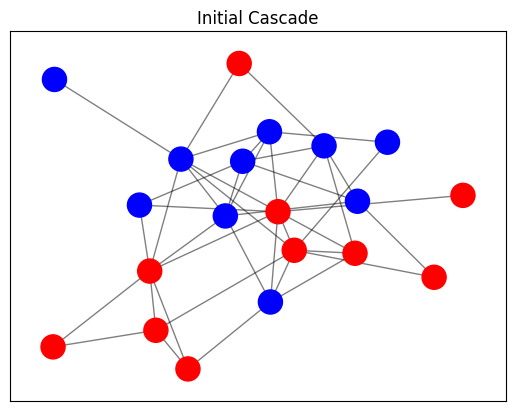

In [97]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import networkx as nx
import random

def animate_cascade(G, seed_nodes, p=0.05, steps=10):
    fig, ax = plt.subplots()
    pos = nx.spring_layout(G)

    active_nodes = set(seed_nodes)
    nx.draw_networkx_edges(G, pos, alpha=0.5, ax=ax)
    colors = ['red' if node in active_nodes else 'blue' for node in G.nodes()]
    nx.draw_networkx_nodes(G, pos, node_color=colors, ax=ax)
    plt.title("Initial Cascade")

    def update(step):
        nonlocal active_nodes
        newly_active = set()
        for node in active_nodes:
            neighbors = set(G.neighbors(node))
            for neighbor in neighbors - active_nodes:
                if random.random() <= p:
                    newly_active.add(neighbor)
        active_nodes.update(newly_active)
        colors = ['red' if node in active_nodes else 'blue' for node in G.nodes()]
        ax.clear()
        nx.draw_networkx_edges(G, pos, alpha=0.5, ax=ax)
        nx.draw_networkx_nodes(G, pos, node_color=colors, ax=ax)
        plt.title(f"Cascade at Step {step}")

    ani = animation.FuncAnimation(fig, update, frames=steps, repeat=False)
    plt.show()

seed_nodes = random.sample(list(G.nodes()), 10)
animate_cascade(G, seed_nodes, p=0.05, steps=10)

In [78]:
import networkx as nx
import matplotlib.pyplot as plt
import pandas as pd

##### SIS Model

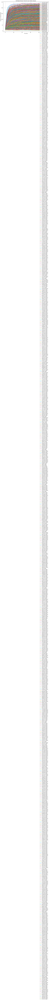

In [85]:
import ndlib.models.ModelConfig as mc
import ndlib.models.epidemics as ep
import networkx as nx
import matplotlib.pyplot as plt
import os

# Define the path to the folder containing .edges files
twitter_folder_path = 'twitter/'

infection_trends = []

for filename in os.listdir(twitter_folder_path):
    if filename.endswith('.edges'):
        edges_file_path = os.path.join(twitter_folder_path, filename)
        G = nx.read_edgelist(edges_file_path, create_using=nx.DiGraph(), nodetype=int)

        degree_centrality = nx.degree_centrality(G)
        betweenness_centrality = nx.betweenness_centrality(G)
        closeness_centrality = nx.closeness_centrality(G)

        top_degree_nodes = sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:10]
        top_betweenness_nodes = sorted(betweenness_centrality, key=betweenness_centrality.get, reverse=True)[:10]
        top_closeness_nodes = sorted(closeness_centrality, key=closeness_centrality.get, reverse=True)[:10]

        infected_nodes = list(set(top_degree_nodes + top_betweenness_nodes + top_closeness_nodes))

        model = ep.SISModel(G)

        config = mc.Configuration()
        config.add_model_parameter("beta", 0.05)  
        config.add_model_parameter("lambda", 0.01)  

        config.add_model_initial_configuration("Infected", infected_nodes)
        model.set_initial_status(config)

        iterations = model.iteration_bunch(50)

        infected_counts = [iteration['node_count'][1] for iteration in iterations]
        infection_trends.append((filename, infected_counts))

plt.figure(figsize=(12, 8))

for filename, infected_counts in infection_trends:
    time_steps = list(range(len(infected_counts)))
    plt.plot(time_steps, infected_counts, label=filename)

plt.title("SIS Model Infection Trend for Each Twitter Dataset")
plt.xlabel("Time Step")
plt.ylabel("Number of Infected Nodes")
plt.legend(loc='upper right')
plt.grid()
plt.show()


##### SIR Model

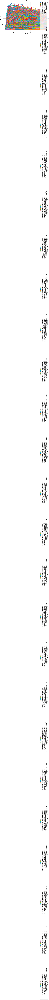

In [99]:
import ndlib.models.ModelConfig as mc
import ndlib.models.epidemics as ep
import networkx as nx
import matplotlib.pyplot as plt
import os

twitter_folder_path = 'twitter/'

infection_trends = []

for filename in os.listdir(twitter_folder_path):
    if filename.endswith('.edges'):
        edges_file_path = os.path.join(twitter_folder_path, filename)
        G = nx.read_edgelist(edges_file_path, create_using=nx.DiGraph(), nodetype=int)

        degree_centrality = nx.degree_centrality(G)
        betweenness_centrality = nx.betweenness_centrality(G)
        closeness_centrality = nx.closeness_centrality(G)

        top_degree_nodes = sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:10]
        top_betweenness_nodes = sorted(betweenness_centrality, key=betweenness_centrality.get, reverse=True)[:10]
        top_closeness_nodes = sorted(closeness_centrality, key=closeness_centrality.get, reverse=True)[:10]

        infected_nodes = list(set(top_degree_nodes + top_betweenness_nodes + top_closeness_nodes))

        model = ep.SIRModel(G)

        config = mc.Configuration()
        config.add_model_parameter("beta", 0.05)  
        config.add_model_parameter("gamma", 0.01) 

        config.add_model_initial_configuration("Infected", infected_nodes)
        model.set_initial_status(config)

        iterations = model.iteration_bunch(50)

        infected_counts = [iteration['node_count'][1] for iteration in iterations]
        infection_trends.append((filename, infected_counts))

plt.figure(figsize=(12, 8))

for filename, infected_counts in infection_trends:
    time_steps = list(range(len(infected_counts)))
    plt.plot(time_steps, infected_counts, label=filename)

plt.title("SIR Model Infection Trend for Each Twitter Dataset")
plt.xlabel("Time Step")
plt.ylabel("Number of Infected Nodes")
plt.legend(loc='upper right')
plt.grid()
plt.show()

##### Independent Cascade Model

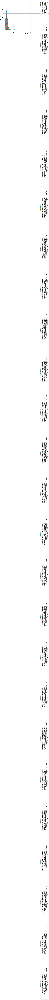

In [87]:
import ndlib.models.ModelConfig as mc
import ndlib.models.epidemics as ep
import networkx as nx
import matplotlib.pyplot as plt
import os

twitter_folder_path = 'twitter/'

# Initialize a list to store infection trends for each file
infection_trends = []

# Iterate over all .edges files in the folder
for filename in os.listdir(twitter_folder_path):
    if filename.endswith('.edges'):
        # Load the Twitter dataset
        edges_file_path = os.path.join(twitter_folder_path, filename)
        G = nx.read_edgelist(edges_file_path, create_using=nx.DiGraph(), nodetype=int)

        # Calculate centralities
        degree_centrality = nx.degree_centrality(G)
        betweenness_centrality = nx.betweenness_centrality(G)
        closeness_centrality = nx.closeness_centrality(G)

        # Get the top 10 nodes by each centrality measure
        top_degree_nodes = sorted(degree_centrality, key=degree_centrality.get, reverse=True)[:10]
        top_betweenness_nodes = sorted(betweenness_centrality, key=betweenness_centrality.get, reverse=True)[:10]
        top_closeness_nodes = sorted(closeness_centrality, key=closeness_centrality.get, reverse=True)[:10]

        # Combine these nodes (removing duplicates) for initial infection
        infected_nodes = list(set(top_degree_nodes + top_betweenness_nodes + top_closeness_nodes))

        # Initialize the IC model on the graph
        model = ep.IndependentCascadesModel(G)

        # Configure the model parameters
        config = mc.Configuration()
        config.add_model_parameter("fraction_infected", 0.1)  # Fraction of nodes initially infected

        # Add initial infected nodes
        config.add_model_initial_configuration("Infected", infected_nodes)
        model.set_initial_status(config)

        # Run the simulation
        iterations = model.iteration_bunch(50)

        # Extract the infection trend
        infected_counts = [iteration['node_count'][1] for iteration in iterations]  # '1' represents infected nodes
        infection_trends.append((filename, infected_counts))

# Plot the infection trends for each file on a single plot
plt.figure(figsize=(12, 8))

for filename, infected_counts in infection_trends:
    time_steps = list(range(len(infected_counts)))
    plt.plot(time_steps, infected_counts, label=filename)

plt.title("Independent Cascade Model Infection Trend for Each Twitter Dataset")
plt.xlabel("Time Step")
plt.ylabel("Number of Infected Nodes")
plt.legend(loc='upper right')
plt.grid()
plt.show()
